In [1]:
""" Clustering representation

    Se pretende en este programa mostrar los distintos métodos
    de clusterizacion dado el centro de transformacion, caracterizando la distribucion de partida y detectando
    los outliers existentes en el interior, asi como permitiendo
    la posibilidad de evaluar la posibilidad de perteniencia de
    un nuevo punto al conjunto de entrenamiento. También, se quiere representar dichos puntos usando PCA.

"""
## LIBRARIES AND DATA
# If having a problem when importing matplotlib, execute pip install msvc-runtime or pip install scipy if error importing seaborn

# Generic libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.utils import shuffle
from sklearn.decomposition import PCA
from sklearn.cluster import OPTICS, DBSCAN
from sklearn.neighbors import LocalOutlierFactor
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.ticker import FuncFormatter
import matplotlib.gridspec as gridspec

import datetime
from datetime import datetime as dt
from datetime import date
from datetime import timedelta


In [2]:
### CONSTANTS
INPUT_SHAPE = 5
LATENT_SHAPE = 3
MIN_SAMPLES = 200                 # INITIAL: 50
MIN_CLUSTER_SIZE = 0.1            # INITIAL: 0.05
EPS = 1.2
N_NEIGHBORS = 20
CONTAMINATION_RATIO = 0.002

COLORS_PALETTE = {'axis1' : ['g.', 'r.', 'b.', 'y.', 'c.']
                  , 'axis2' : ['g', 'greenyellow', 'olive', 'r', 'b', 'c']
                  , 'axis3' : ['g.', 'm.', 'y.', 'c.']
                  , 'axis4' : ['g.', 'y.', 'c.', 'm.']}

In [3]:
### DATA EXTRACTION AND PREPARATION
# Numeric values extraction (excel LVSM_Def.xlsx)
values_column_names = ["time", "branch" , "organization", "substation", "transformer_code", "App SW", 
                        "V_L1", "I_L1", "W_L1", "QL_L1", "QC_L1","cos_L1", "angle_L1",
                        "V_L2", "I_L2", "W_L2", "QL_L2", "QC_L2","cos_L2", "angle_L2",
                        "V_L3", "I_L3", "W_L3", "QL_L3", "QC_L3","cos_L3", "angle_L3",
                        "temp_amb",
                        "aplus_L1", "aminus_L1", "RplusL_L1", "RminusL_L1", "RplusC_L1", "RminusC_L1", 
                        "aplus_L2", "aminus_L2", "RplusL_L2", "RminusL_L2", "RplusC_L2", "RminusC_L2",
                        "aplus_L3", "aminus_L3", "RplusL_L3", "RminusL_L3", "RplusC_L3", "RminusC_L3"]

# Retrieve data on values
# script_path = os.path.dirname(__file__)
# Read csv from local file
data_lvsm = pd.read_csv('../DATA/LVSM_Def.csv',  sep = ';', header=0, names=values_column_names)

# Read csv from GitHub
# url_data = 'https://gitlab.com/Ander_gargas/tfm-cic/-/raw/master/Listado_Trafos.csv'
# data_lvsm = pd.read_csv(url_data,  sep = ';', header=0, names=values_column_names, encoding='latin-1')

# Cleaning data table
data = data_lvsm.drop(["aplus_L1", "aminus_L1", "RplusL_L1", "RminusL_L1", "RplusC_L1", "RminusC_L1", 
                  "aplus_L2", "aminus_L2", "RplusL_L2", "RminusL_L2", "RplusC_L2", "RminusC_L2",
                  "aplus_L3", "aminus_L3", "RplusL_L3", "RminusL_L3", "RplusC_L3", "RminusC_L3"], axis=1)
data = data.reset_index(drop = True)

# Change column types to appropiate
data = data.astype({"time": str, "branch": str , "organization": str, "substation": str, "transformer_code": str, "App SW": str})

data[["V_L1", "I_L1", "W_L1", "QL_L1", "QC_L1","cos_L1", "angle_L1",
      "V_L2", "I_L2", "W_L2", "QL_L2", "QC_L2","cos_L2", "angle_L2",
      "V_L3", "I_L3", "W_L3", "QL_L3", "QC_L3","cos_L3", "angle_L3",
      "temp_amb"]] = data[["V_L1", "I_L1", "W_L1", "QL_L1", "QC_L1","cos_L1", "angle_L1",
                           "V_L2", "I_L2", "W_L2", "QL_L2", "QC_L2","cos_L2", "angle_L2",
                           "V_L3", "I_L3", "W_L3", "QL_L3", "QC_L3","cos_L3", "angle_L3",
                           "temp_amb"]].astype(float)

### Deal with the "24:00" problem. Adapt BOTH the hour and the day. 
# Get the indexes and replace hour
for i, date in enumerate(data['time']):
    if date.split()[1].split(':')[0] == '24':
        data.loc[i, 'time'] = data.loc[i, 'time'].replace("24:00","00:00")
        data.loc[i, 'time'] = pd.to_datetime(data.loc[i, 'time'], format = '%Y-%m-%d %H:%M') + timedelta(days = 1)

# Update the format
data['time'] = pd.to_datetime(data['time'], format = '%Y-%m-%d %H:%M:%S')

# Copy of the dataframe to split date and hour
data_new = data.copy(deep=True)

# Split the time column into date and hour columns, for diagram's input preparation
data_new['date'] = (data_new['time']).dt.date
data_new['hour'] = (data_new['time']).dt.time

# Delete the old time column
data_new = data_new.drop(["time"], axis=1)

# Put both columns at the start
data_new = pd.concat([data_new['hour'], data_new.drop('hour',axis=1)], axis=1)
data_new = pd.concat([data_new['date'], data_new.drop('date',axis=1)], axis=1)

# Cleaning NA values
if data_new.isna().sum().sum() < .10 * len(data_new): 
    # print ("Cleaning NA values from dataset")
    data_new = data_new.dropna()
else:
    raise Exception("Careful! Deleting NaN values would cut most of the dataset")

# Remove duplicates
if data.duplicated().sum() < .10 * len(data_new): 
    # print ("Cleaning duplicate values from dataset")
    data_new = data_new.drop_duplicates(subset=['date', 'hour', 'substation', 'App SW'])
else:
    raise Exception("Careful! Deleting duplicated values would cut most of the dataset")

print('The data is ready!')

The data is ready!


In [4]:
# Feature extraction
feat_names = ["V_L1", "I_L1", "W_L1", "QL_L1", "QC_L1"]
X = data_new[feat_names].to_numpy()
date_list = data_new["date"].to_numpy()

substation_coding = {v: i for i, v in enumerate(np.unique(data_new[["substation"]]))}

trafo_list = data_new["substation"].map(substation_coding).array

In [5]:
# Part 0: Dataset Preparation
# Since we are performing a clustering problem, no split is needed since a validation is useless without a prior knowledge or labeling of
# input data

# Standardize Data
sc = StandardScaler()
X_std = sc.fit_transform(X)

In [6]:
### PCA Creation and codings representation on latent space
pca = PCA(n_components=LATENT_SHAPE, svd_solver='auto')
codings = pca.fit_transform(X_std)

In [7]:
# Visualization check
print("original shape:   ", X_std.shape)
print("transformed shape:", codings.shape, '\n')

original shape:    (164434, 5)
transformed shape: (164434, 3) 



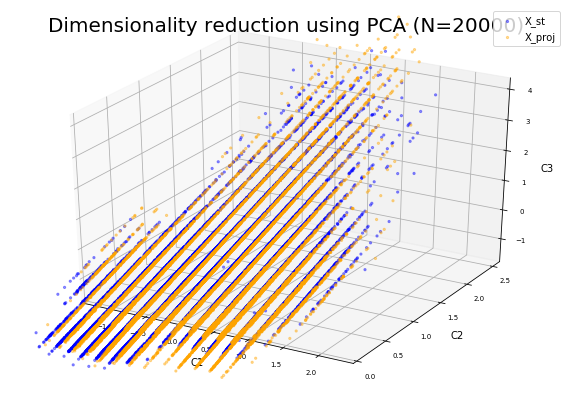

In [8]:
N = 20000
X_proj_std = pca.inverse_transform(codings)
X_proj = sc.inverse_transform(X_proj_std)

plt.figure(figsize=(10, 7))
ax = plt.axes(projection ="3d")
ax.scatter(X_std[:N, 0], X_std[:N, 1], zs = X_std[:N, 2], c = 'blue', marker = '.', alpha=0.4)
ax.scatter(X_proj_std[:N, 0], X_proj_std[:N, 1], zs = X_proj_std[:N, 2], c = 'orange', marker = '.', alpha=0.4)
ax.tick_params(labelsize = 7)
ax.set_xlabel('C1')
ax.set_ylabel('C2')
ax.set_zlabel('C3')

ax.set_title('Dimensionality reduction using PCA (N=' + str(N) + ')', fontsize = 20)
plt.legend(labels=['X_st', 'X_proj'], loc='upper right')
plt.axis('equal');


pca_ratio: [0.4859637  0.22167722 0.17787981]



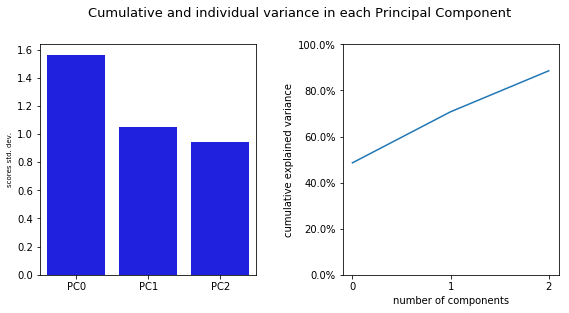

In [9]:
# Variance in PCA method
fig, axes = plt.subplots(1, 2, figsize=(8, 4))
fig.suptitle('Cumulative and individual variance in each Principal Component', fontsize = 13)
# set the spacing between subplots
plt.subplots_adjust(left=0.05,
                    bottom=0.05, 
                    right=0.95, 
                    top=0.85, 
                    wspace=0.4, 
                    hspace=0.5)

coding_columns = ['PC0','PC1','PC2']
scores_stddev_values = np.std(codings, axis = 0)
scores_stddev = pd.DataFrame({'names': coding_columns, 'values': scores_stddev_values})

# Axes 0: PCA scores
sns.barplot(ax=axes[0], x='names', y='values', data=scores_stddev, color='blue')
axes[0].set_ylabel('scores std. dev.', fontsize = 7)
axes[0].set_xlabel('')

# Axes 1: Cumulative variance in PCA
axes[1].plot(np.cumsum(pca.explained_variance_ratio_))
axes[1].set_xlabel('number of components')
axes[1].set_ylabel('cumulative explained variance')
vals = axes[1].get_yticks()
axes[1].yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.1%}'.format(y)))
axes[1].set_xticks(ticks = [0, 1, 2])

axes[1].set_ylim(0, 1)
print('\npca_ratio: ' + str(pca.explained_variance_ratio_) + '\n')

In [10]:
print(pca.explained_variance_ratio_)

[0.4859637  0.22167722 0.17787981]


In [11]:
# Reduce the training data after shuffling
indices = np.arange(X_std.shape[0])
np.random.shuffle(indices)

X_std_tr = X_std[indices][:N]
codings_tr = codings[indices][:N]
date_tr = date_list[indices][:N]
trafo_tr = trafo_list[indices][:N]

In [12]:
# Model 1: Automatic Clustering OPTICS
startTime = dt.now()
clust = OPTICS(min_samples = MIN_SAMPLES, min_cluster_size = None)
clust.fit(codings_tr)
print('OPTICS Model trained')

space = np.arange(len(codings_tr))
reachability = clust.reachability_[clust.ordering_]
labels = clust.labels_[clust.ordering_]

print('Time spent for training model and outcome representation: ')
print(dt.now() - startTime)

OPTICS Model trained
Time spent for training model and outcome representation: 
0:00:47.846793


In [13]:
# Model 2: DBSCAN with SMALL_EPS
startTime = dt.now()

SMALL_EPS = 0.3
db_small = DBSCAN(eps = SMALL_EPS, min_samples = 0.001 * len(codings_tr)).fit(codings_tr)
labels_small_eps = db_small.labels_

# labels_small_eps = cluster_optics_dbscan(reachability = clust.reachability_,
#                                     core_distances = clust.core_distances_,
#                                     ordering = clust.ordering_, eps = SMALL_EPS)

print('DBSCAN Model with eps = 0.3 trained')
print('Time spent for training model and outcome representation: ')
print(dt.now() - startTime)

DBSCAN Model with eps = 0.3 trained
Time spent for training model and outcome representation: 
0:00:00.632519


In [14]:
# Model 3: DBSCAN with HIGH_EPS
startTime = dt.now()

HIGH_EPS = 0.7
db_high = DBSCAN(eps = HIGH_EPS, min_samples = 0.001 * len(codings_tr)).fit(codings_tr)
labels_high_eps = db_high.labels_

# labels_high_eps = cluster_optics_dbscan(reachability = clust.reachability_,
#                                     core_distances = clust.core_distances_,
#                                     ordering = clust.ordering_, eps = HIGH_EPS)

print('DBSCAN Model with eps = 0.7 trained')
print('Time spent for training model and outcome representation: ')
print(dt.now() - startTime)

DBSCAN Model with eps = 0.7 trained
Time spent for training model and outcome representation: 
0:00:02.110725


In [15]:
# Model 4: LOF algorithm
startTime = dt.now()

model_outlier_detector = LocalOutlierFactor(n_neighbors = N_NEIGHBORS, contamination = CONTAMINATION_RATIO) 
y_pred = model_outlier_detector.fit_predict(codings_tr)

# Filter outlier index
outlier_index = np.where(y_pred == -1)       # -1 values are outliers
inlier_index = np.where(y_pred != -1)        # 1 values are points from same distribution

print('LOF Model trained')
print('Time spent for training model and outcome representation: ')
print(dt.now() - startTime)

LOF Model trained
Time spent for training model and outcome representation: 
0:00:00.288942


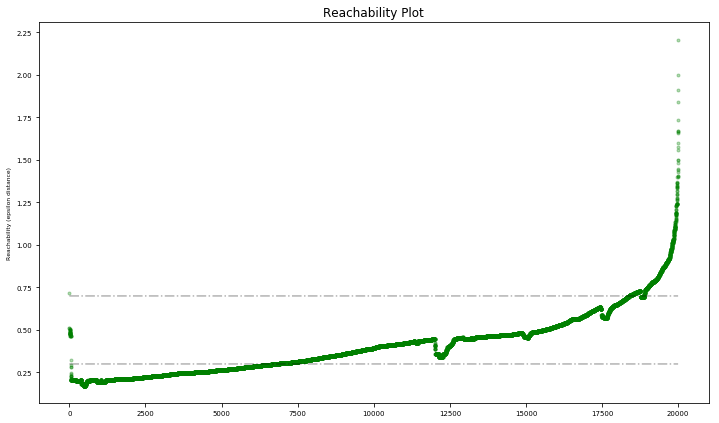

In [16]:
# Reachability plot from OPTICS clustering
plt.figure(figsize=(12, 7))

colors = ['g.', 'r.', 'b.', 'y.', 'c.']
unique_opt = len(set(labels))
for klass, color in zip(range(0, unique_opt), colors):
    Xk = space[labels == klass]
    Rk = reachability[labels == klass]
    plt.plot(Xk, Rk, color, alpha=0.3)
plt.plot(space[labels == -1], reachability[labels == -1], 'k.', alpha=0.3)
plt.plot(space, np.full_like(space, SMALL_EPS, dtype=float), 'k-.', alpha=0.3)
plt.plot(space, np.full_like(space, HIGH_EPS, dtype=float), 'k-.', alpha=0.3)
plt.ylabel('Reachability (epsilon distance)', fontsize = 6)
plt.title('Reachability Plot', fontsize = 12)
plt.tick_params(labelsize = 7)

In [17]:
def subplot(number: int, axis_name: plt.subplot, X: np.array, labels: np.array, mode: str = '2d'):
    """This function intakes all the input in order to be able to draw a subplot in the Reachability Digram

    Args:
        number (int): This number is an identifier on the axis name
        axis_name (plt.subplot): Variable which holds the information on a given subplot    
        X (np.array): Data coordinates in a tuple (x, y, z) 
        labels (np.array): Classification in clusters by the algorithm
        mode (string): euther in '2d' or in '3d'. Defaults to '2d'.
        
    Raises:
        Exception: Happens when mode has not been selected
    """
    unique_lab = len(set(labels))

    if mode == '2d':
        for klass, color in zip(range(0, unique_lab), COLORS_PALETTE['axis' + str(number)]):
            Xk = X[labels == klass]
            axis_name.plot(Xk[:, 0], Xk[:, 1], color, alpha=0.3, marker='.')
        axis_name.plot(X[labels == -1, 0], X[labels == -1, 1], 'k+', alpha=0.1)
        axis_name.tick_params(labelsize = 7)
        axis_name.set_xlabel('Width')
        axis_name.set_ylabel('Length')
        
    elif mode == '3d':
        for klass, color in zip(range(0, unique_lab), COLORS_PALETTE['axis' + str(number)]):
            Xk = X[labels == klass]
            axis_name.scatter(Xk[:, 0], Xk[:, 1], zs = Xk[:, 2], c = color.replace('.',''), marker = '.')
        axis_name.scatter(X[labels == -1, 0], X[labels == -1, 1], X[labels == -1, 2], c='k', marker='.', alpha=0.8)
        axis_name.tick_params(labelsize = 7)
        axis_name.set_xlabel('C1')
        axis_name.set_ylabel('C2')
        axis_name.set_zlabel('C3')

    else:
        raise Exception("Try a proper representation mode")


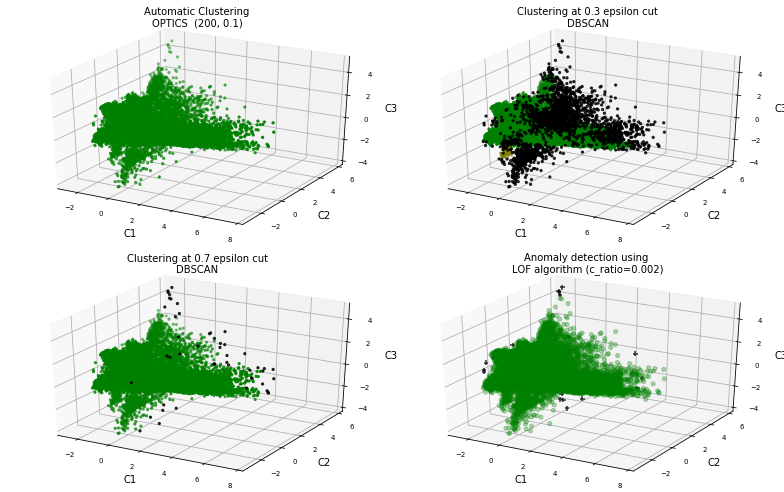

In [18]:
### PLOTTING FIRST FIGURE
plt.figure(figsize=(11, 7))
G = gridspec.GridSpec(2, 2)
ax1 = plt.subplot(G[0, 0], projection='3d')
ax2 = plt.subplot(G[0, 1], projection='3d')
ax3 = plt.subplot(G[1, 0], projection='3d')
ax4 = plt.subplot(G[1, 1], projection='3d')

# Axis 1: OPTICS
subplot(1, ax1, codings_tr, clust.labels_, mode = '3d')
ax1.set_title('Automatic Clustering\nOPTICS  (' + str(MIN_SAMPLES) + ', ' + str(MIN_CLUSTER_SIZE) + ')', fontsize = 10)

# Axis 2: DBSCAN at SMALL EPS
subplot(2, ax2, codings_tr, labels_small_eps, mode = '3d')
ax2.set_title('Clustering at ' + str(SMALL_EPS) + ' epsilon cut\nDBSCAN', fontsize = 10)

# Axis 3: DBSCAN at HIGH EPS
subplot(3, ax3, codings_tr, labels_high_eps, mode = '3d')
ax3.set_title('Clustering at ' + str(HIGH_EPS) + ' epsilon cut\nDBSCAN', fontsize = 10)

# Axis 4: LOF Algorithm, the one performing the novelty detection
ax4.scatter(codings_tr[inlier_index, 0], codings_tr[inlier_index, 1], zs = codings_tr[inlier_index, 2], c = "g", s = 65, marker = '.', alpha = 0.3)
ax4.scatter(codings_tr[outlier_index, 0], codings_tr[outlier_index, 1], codings_tr[outlier_index, 2], c='k', marker='+', alpha=0.8)
ax4.tick_params(labelsize = 7)
ax4.set_xlabel('C1')
ax4.set_ylabel('C2')
ax4.set_zlabel('C3')
ax4.set_title('Anomaly detection using \nLOF algorithm (c_ratio=' + str(CONTAMINATION_RATIO) + ')', fontsize = 10)

plt.tight_layout()
plt.savefig('Comparison between algorithms fetching outliers.png')
plt.show()

In [19]:
print('\nAlgorithm used for outlier detection: OPTICS')
print('Number of counted outliers out of ' + str(N) + ': ')
print(np.count_nonzero(clust.labels_ == -1))

print('\nAlgorithm used for outlier detection: DBSCAN')
print('Number of counted outliers out of ' + str(N) + ': ')
print('SMALL_EPS: ' + str(np.count_nonzero(labels_small_eps == -1)) + ', HIGH_EPS: ' + str(np.count_nonzero(labels_high_eps[:N] == -1)))

print('\nAlgorithm used for outlier detection: Local Outlier Factor')
print('Number of counted outliers out of ' + str(N) + ': ')
print(np.count_nonzero(model_outlier_detector.negative_outlier_factor_ < model_outlier_detector.offset_))


Algorithm used for outlier detection: OPTICS
Number of counted outliers out of 20000: 
0

Algorithm used for outlier detection: DBSCAN
Number of counted outliers out of 20000: 
SMALL_EPS: 1980, HIGH_EPS: 47

Algorithm used for outlier detection: Local Outlier Factor
Number of counted outliers out of 20000: 
40


In [20]:
print('Please, select the transformer code being source of this data: \n')
print('Possible options: ')
print(substation_coding)
# trafo_code = int(input('Number (0-19): '))
trafo_code = 11

print('Please, select the month from which you want to see data: \n')        # Week 24 2019 -> Week 24 2020 
# begin_month = input('Number (0-12): ')
begin_month = '8'
print('Please, select the year from which you want to see data: \n')         
# begin_year = input('Number (2019-2020): ')
begin_year = '2019'
begin_date = pd.to_datetime(begin_year + '-' + begin_month + '-01', format = '%Y-%m-%d')

print('Please, select the month until which you want to see data: \n')
# end_month = input('Number (0-12): ')
end_month = '11'
print('Please, select the year until which you want to see data: \n')         
# end_year = input('Number (2019-2020): ')
end_year = '2019'
end_date = pd.to_datetime(end_year + '-' + end_month + '-01', format = '%Y-%m-%d')

print('\nData samples registered. Now testing...\n')

Please, select the transformer code being source of this data: 

Possible options: 
{'S201': 0, 'S2274': 1, 'S242': 2, 'S286': 3, 'S287': 4, 'S406': 5, 'S480': 6, 'S499': 7, 'S531': 8, 'S612': 9, 'S68638': 10, 'S7116': 11, 'S733': 12, 'S740': 13, 'S744': 14, 'S76020': 15, 'S813': 16, 'S820': 17, 'S850': 18, 'S868': 19}
Please, select the month from which you want to see data: 

Please, select the year from which you want to see data: 

Please, select the month until which you want to see data: 

Please, select the year until which you want to see data: 


Data samples registered. Now testing...



In [21]:
def test_outlier(codings_CT: np.array, codings_selected: np.array, CT: str, begin_date: dt.date, end_date: dt.date) -> (np.array, str):
    """Checking which points from selection are considered outliers, out of the total of points from that CT considering the codings following the DBSCAN with eps = 0.75 

    Args:
        codings_CT (np.array): Standarized array of codings from the CT. Used to train the model.
        codings_selected (np.array): From the previous data set, selection made by the user between being_date and end_date. These points will be the one evaluated by the clustering algorithm.
        CT (str): code of the selected CT. Starting by a "S", it will be one of the keys of the substation_coding dictionary
        begin_date (str): Opening boundary for the timeframe selection from user.
        end_date (str): Closing boundary for the timeframe selection from user.

    Returns:
        pred_outlier (tuple): labels qualifying outliers for this CT with a -1
        msg (List(str)): Message to be displayed on the window for the user
    """
    HIGH_EPS = 0.7

    db_high = DBSCAN(eps = HIGH_EPS, min_samples = 0.001 * len(codings_CT)).fit(codings_CT)
    labels_high_eps = db_high.labels_

    indices_outliers = np.where(labels_high_eps == -1)

    if not np.where(labels_high_eps == -1)[0].size > 0:
        n_outlier = 0
        msg = ('\nAmong the dates {} and {}, {} points were found in total belonging to the CT {}. Among these, none of them are outliers.\n'.format(begin_date.strftime("%Y-%m-%d"), end_date.strftime("%Y-%m-%d"), len(codings_selected), CT))

    else:    
        n_outlier = len(indices_outliers)
        msg = ('\nAmong the dates {} and {}, {} points were found in total belonging to the CT {}. Among these, {} of them are outliers.\n'.format(begin_date.strftime("%Y-%m-%d"), end_date.strftime("%Y-%m-%d"), len(codings_selected), CT, n_outlier))

    return labels_high_eps, msg

In [22]:
# Get the result of the analysis 
# X_CT = X_std_tr[trafo_tr == trafo_code]
# X_selected = X_std_tr[(trafo_tr == trafo_code) & (begin_date <= date_tr) & (date_tr <= end_date)]
# pred_new = test_outlier(X_CT, X_selected, list(substation_coding.keys())[list(substation_coding.values()).index(trafo_code)], begin_date, end_date)
# print(pred_new)

codings_CT = codings[trafo_list == trafo_code]
date_list_CT = date_list[trafo_list == trafo_code]
codings_selected = codings[(trafo_list == trafo_code) & (begin_date <= date_list) & (date_list <= end_date)]

pred_outlier, msg = test_outlier(codings_CT, codings_selected, list(substation_coding.keys())[list(substation_coding.values()).index(trafo_code)], begin_date, end_date)
print(msg)


Among the dates 2019-08-01 and 2019-11-01, 2218 points were found in total belonging to the CT S7116. Among these, none of them are outliers.



In [23]:
def plot_result(codings_CT: np.array, codings_inlier: np.array, codings_outlier: np.array):
    """Plotting the training set for a given CT along with the selected points, varying in color depending if it is defined as an outlier

    Args:
        codings_CT (np.array): Standarized array of codings from the CT. Used to train the model.
        codings_inlier (np.array): From the selected timeframe dataset, those being qualified as inlier. These points were evaluated by the clustering.
        codings_outlier (np.array): From the selected timeframe dataset, those being qualified as outlier. These points were evaluated by the clustering.
    """
    plt.figure(figsize=(11, 7))
    ax = plt.axes(projection ="3d")

    # Plot training set
    ax.scatter(codings_CT[:, 0], codings_CT[:, 1], zs = codings_CT[:, 2], c = 'b', marker = '.', alpha=0.05)

    # Plot selected data, inlier
    ax.scatter(codings_inlier[:, 0], codings_inlier[:, 1], codings_inlier[:, 2], c='g', marker='.', alpha=0.8, s=20)

    # Plot selected data, outlier
    if codings_outlier.size > 0:
        if codings_outlier.size == 1:
            ax.scatter(codings_outlier[0], codings_outlier[1], codings_outlier[2], c='r', marker='+', alpha=0.8, s=150)
        else:
            ax.scatter(codings_outlier[:, 0], codings_outlier[:, 1], codings_outlier[:, 2], c='r', marker='+', alpha=0.8, s=150)

    ax.tick_params(labelsize = 7)
    ax.set_xlabel('C1')
    ax.set_ylabel('C2')
    ax.set_zlabel('C3')

    ax.set_title('Outlier detection using \nDBSCAN algorithm (eps=' + str(HIGH_EPS) + ')', fontsize = 20)

    plt.tight_layout()
    plt.savefig('Results particular case.png')
    plt.show()

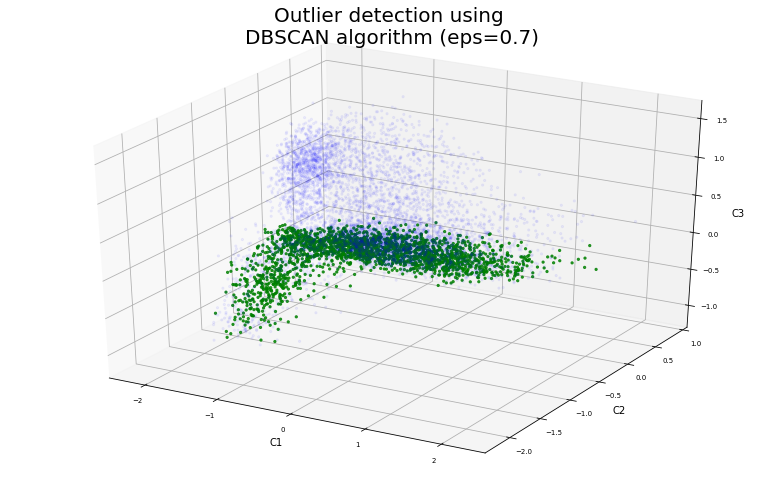

In [28]:
# Plotting results
plot_result(codings_CT[(dt_begin_date >= date_list_CT) | (date_list_CT >= dt_end_date)], codings_CT[(pred_outlier != -1) & (begin_date <= date_list_CT) & (date_list_CT <= end_date)], codings_CT[(pred_outlier == -1) & (begin_date <= date_list_CT) & (date_list_CT <= end_date)])